In [9]:
from PIL import Image
#from cityscapesscripts.helpers import labels
from cityscapesscripts.helpers import labels as cs_labels
import matplotlib.pyplot as plt
import numpy as np
import os
import random
import time
import gc
from tqdm.auto import tqdm
import torch
import torch.nn.functional as F
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import random_split
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from torchvision.models.segmentation import deeplabv3_resnet50, DeepLabV3_ResNet50_Weights
from backbones_unet.model.unet import Unet

# Setup

In [10]:
# Set seeds for reproducibility
def set_seeds(seed=42):
    """Set seeds for reproducibility"""
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.mps.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False

# Set the seed
SEED = 42
set_seeds(SEED)
print(f"Seeds set for reproducibility is {SEED}")

DEVICE = torch.device("cuda" if torch.cuda.is_available() 
                      else "mps" if torch.mps.is_available() 
                      else "cpu"
                    )
print(DEVICE)

from contextlib import contextmanager
import ssl
# Disable SSL verification for urllib requests on MacOS
# This is a workaround for the "SSL: CERTIFICATE_VERIFY_FAILED" error on MacOS
@contextmanager
def no_ssl_verification():
    """Temporarily disable SSL verification"""
    old_context = ssl._create_default_https_context
    ssl._create_default_https_context = ssl._create_unverified_context
    try:
        yield
    finally:
        ssl._create_default_https_context = old_context

Seeds set for reproducibility is 42
mps


In [11]:
class SegmentationDataset(Dataset):
    def __init__(self, images_dir, targets_dir, image_transform=None, target_transform=None):
        """
        Args:
            images_dir (string): Directory with all the images.
            targets_dir (string): Directory with all the target masks.
            image_transform (callable, optional): Optional transform to be applied on images.
            target_transform (callable, optional): Optional transform to be applied on targets.
        """
        self.images_dir = images_dir
        self.targets_dir = targets_dir
        self.image_transform = image_transform
        self.target_transform = target_transform
        
        # Get all image filenames
        self.image_filenames = [f for f in os.listdir(images_dir) 
                               if f.lower().endswith(('.png'))]
        self.image_filenames.sort()
        
    def __len__(self):
        return len(self.image_filenames)
    
    def __getitem__(self, idx):
        # Load image
        img_name = self.image_filenames[idx]
        img_path = os.path.join(self.images_dir, img_name)
        image = Image.open(img_path).convert('RGB')
        
        # Load target mask
        target_name = img_name.replace('.png', '_trainId.png')
        target_path = os.path.join(self.targets_dir, target_name)
        target = Image.open(target_path)
        
        # Apply transforms
        if self.image_transform:
            image = self.image_transform(image)
        
        if self.target_transform:
            target = self.target_transform(target)
       # else:
       #     # Default: convert to tensor
       #     target = torch.from_numpy(target)
        
        return image, target

In [12]:
# Create color map for segmentation (using Cityscapes colors)
#from cityscapesscripts.helpers import labels as cs_labels
def visualize_segmentation(model, dataloader, num_samples=4, start_idx=0, deterministic=False):
    """
    Visualize segmentation results from the model
    
    Args:
        model: The model to evaluate
        dataloader: DataLoader containing images and targets
        num_samples: Number of samples to visualize
        start_idx: Starting index for deterministic sampling (used when deterministic=True)
        deterministic: If True, select images deterministically by index
    """
    model.eval()
    
    # Get images for visualization
    if deterministic:
        # For true determinism, access the dataset directly instead of the dataloader
        # This avoids the randomness caused by shuffle=True
        dataset = dataloader.dataset
        
        # Handle the case where the dataset is a Subset (from random_split)
        if hasattr(dataset, 'dataset') and hasattr(dataset, 'indices'):
            # This is a Subset from random_split
            #print("Handling Subset dataset case")
            orig_dataset = dataset.dataset
            indices = dataset.indices
            
            # Select specific indices
            selected_indices = indices[start_idx:start_idx + num_samples]
            
            # Get samples directly from the original dataset
            images = []
            targets = []
            for idx in selected_indices:
                img, tgt = orig_dataset[idx]
                images.append(img.unsqueeze(0))  # Add batch dimension
                targets.append(tgt.unsqueeze(0))
            
            # Stack to form batches
            images = torch.cat(images, dim=0)
            targets = torch.cat(targets, dim=0)
        else:
            # Regular dataset
            images = []
            targets = []
            for i in range(start_idx, min(start_idx + num_samples, len(dataset))):
                img, tgt = dataset[i]
                images.append(img.unsqueeze(0))
                targets.append(tgt.unsqueeze(0))
            
            # Stack to form batches
            images = torch.cat(images, dim=0)
            targets = torch.cat(targets, dim=0)
    else:
        # Non-deterministic: Just get the next batch
        images, targets = next(iter(dataloader))
        
        # Limit to the required number of samples
        images = images[:num_samples]
        targets = targets[:num_samples]
    
    # Ensure we don't use more than available
    #num_samples = min(num_samples, len(images))
    
    images = images[:num_samples].to(DEVICE)
    targets = targets[:num_samples].to(DEVICE)
    
    with torch.no_grad():
        outputs = model(images)['out']
        predictions = torch.argmax(outputs, dim=1)
    
    # Move to CPU for visualization
    images = images.cpu()
    targets = targets.cpu()
    predictions = predictions.cpu()
    
    def apply_color_map(seg_map):
        """Apply color mapping to segmentation map"""
        colored_map = np.zeros((seg_map.shape[0], seg_map.shape[1], 3), dtype=np.uint8)
        
        # Get valid labels (excluding ignore classes)
        valid_labels = [label for label in cs_cs_labels.labels if label.trainId != 255 and label.trainId != -1]
        
        for label in valid_labels:
            mask = seg_map == label.trainId
            colored_map[mask] = label.color
            
        return colored_map
    
    # Plot results
    fig, axes = plt.subplots(num_samples, 3, figsize=(15, num_samples * 4))
    if num_samples == 1:
        axes = axes.reshape(1, -1)
    
    for i in range(min(num_samples, len(images))):
        # Original image
        img = images[i].permute(1, 2, 0).numpy()
        img = (img - img.min()) / (img.max() - img.min())  # Normalize for display
        axes[i, 0].imshow(img)
        axes[i, 0].set_title('Original Image')
        axes[i, 0].axis('off')
        
        # Ground truth
        gt_colored = apply_color_map(targets[i].numpy())
        axes[i, 1].imshow(gt_colored)
        axes[i, 1].set_title('Ground Truth')
        axes[i, 1].axis('off')
        
        # Prediction
        pred_colored = apply_color_map(predictions[i].numpy())
        axes[i, 2].imshow(pred_colored)
        axes[i, 2].set_title('Prediction')
        axes[i, 2].axis('off')
    
    plt.tight_layout()
    plt.show()

In [13]:
def visualize_segmentation_with_background(model, dataloader, num_samples=4, start_idx=0, deterministic=False, 
                                         confidence_threshold=0.5, entropy_threshold=2.0, method='entropy'):
    """
    Visualize segmentation results with background detection
    
    Args:
        model: The model to evaluate
        dataloader: DataLoader containing images and targets
        num_samples: Number of samples to visualize
        start_idx: Starting index for deterministic sampling
        deterministic: If True, select images deterministically by index
        confidence_threshold: Minimum confidence for non-background classification
        entropy_threshold: Maximum entropy for non-background classification
        method: Background detection method ('entropy', 'confidence', 'combined')
    """
    model.eval()
    
    # Get images for visualization (using your existing logic)
    if deterministic:
        dataset = dataloader.dataset
        
        if hasattr(dataset, 'dataset') and hasattr(dataset, 'indices'):
            orig_dataset = dataset.dataset
            indices = dataset.indices
            selected_indices = indices[start_idx:start_idx + num_samples]
            
            images = []
            targets = []
            for idx in selected_indices:
                img, tgt = orig_dataset[idx]
                images.append(img.unsqueeze(0))
                targets.append(tgt.unsqueeze(0))
            
            images = torch.cat(images, dim=0)
            targets = torch.cat(targets, dim=0)
        else:
            images = []
            targets = []
            for i in range(start_idx, min(start_idx + num_samples, len(dataset))):
                img, tgt = dataset[i]
                images.append(img.unsqueeze(0))
                targets.append(tgt.unsqueeze(0))
            
            images = torch.cat(images, dim=0)
            targets = torch.cat(targets, dim=0)
    else:
        images, targets = next(iter(dataloader))
        images = images[:num_samples]
        targets = targets[:num_samples]
    
    images = images[:num_samples].to(DEVICE)
    targets = targets[:num_samples].to(DEVICE)
    
    with torch.no_grad():
        #outputs = model(images)['out']
        outputs = model(images)
        if isinstance(outputs, dict) and 'out' in outputs:
            outputs = outputs['out']
        
        # Get softmax probabilities
        probabilities = F.softmax(outputs, dim=1)
        
        # Get predictions and confidence scores
        max_probs, predictions = torch.max(probabilities, dim=1)
        
        # Calculate entropy for uncertainty estimation
        entropy = -torch.sum(probabilities * torch.log(probabilities + 1e-8), dim=1)
        
        # Apply background detection based on method
        if method == 'confidence':
            # Low confidence -> background
            background_mask = max_probs < confidence_threshold
        elif method == 'entropy':
            # High entropy -> background (uncertain predictions)
            background_mask = entropy > entropy_threshold
        elif method == 'combined':
            # Combine both criteria
            background_mask = (max_probs < confidence_threshold) | (entropy > entropy_threshold)
        else:
            background_mask = torch.zeros_like(predictions, dtype=torch.bool)
        
        # Set background pixels to a special value (e.g., 255 or -1)
        predictions_with_bg = predictions.clone()
        predictions_with_bg[background_mask] = 255  # Use 255 for background
    
    # Move to CPU for visualization
    images = images.cpu()
    targets = targets.cpu()
    predictions = predictions.cpu()
    predictions_with_bg = predictions_with_bg.cpu()
    max_probs = max_probs.cpu()
    entropy = entropy.cpu()
    
    def apply_color_map_with_background(seg_map):
        """Apply color mapping to segmentation map with black background"""
        colored_map = np.zeros((seg_map.shape[0], seg_map.shape[1], 3), dtype=np.uint8)
        
        # Get valid labels (excluding ignore classes)
        valid_labels = [label for label in labels if label.trainId != 255 and label.trainId != -1]
        
        for label in valid_labels:
            mask = seg_map == label.trainId
            colored_map[mask] = label.color
        
        # Background pixels remain black (0, 0, 0)
        return colored_map
    
    # Plot results
    fig, axes = plt.subplots(num_samples, 4, figsize=(20, num_samples * 4))
    if num_samples == 1:
        axes = axes.reshape(1, -1)
    
    for i in range(min(num_samples, len(images))):
        # Original image
        img = images[i].permute(1, 2, 0).numpy()
        img = (img - img.min()) / (img.max() - img.min())
        axes[i, 0].imshow(img)
        axes[i, 0].set_title('Original Image')
        axes[i, 0].axis('off')
        
        # Ground truth
        gt_colored = apply_color_map_with_background(targets[i].numpy())
        axes[i, 1].imshow(gt_colored)
        axes[i, 1].set_title('Ground Truth')
        axes[i, 1].axis('off')
        
        # Prediction without background detection
        pred_colored = apply_color_map_with_background(predictions[i].numpy())
        axes[i, 2].imshow(pred_colored)
        axes[i, 2].set_title('Prediction (Original)')
        axes[i, 2].axis('off')
        
        # Prediction with background detection
        pred_bg_colored = apply_color_map_with_background(predictions_with_bg[i].numpy())
        axes[i, 3].imshow(pred_bg_colored)
        axes[i, 3].set_title(f'Prediction (w/ BG)\n{method}')
        axes[i, 3].axis('off')
        
    
    plt.tight_layout()
    plt.show()
    
    # Print some statistics
    print(f"\nBackground Detection Statistics (method: {method}):")
    for i in range(min(num_samples, len(images))):
        if method == 'confidence':
            bg_pixels = (max_probs[i] < confidence_threshold).sum().item()
        elif method == 'entropy':
            bg_pixels = (entropy[i] > entropy_threshold).sum().item()
        else:  # combined
            bg_pixels = ((max_probs[i] < confidence_threshold) | 
                        (entropy[i] > entropy_threshold)).sum().item()
        
        total_pixels = predictions[i].numel()
        bg_percentage = (bg_pixels / total_pixels) * 100
        print(f"Sample {i}: {bg_pixels}/{total_pixels} pixels ({bg_percentage:.1f}%) classified as background")

Actual Colors:


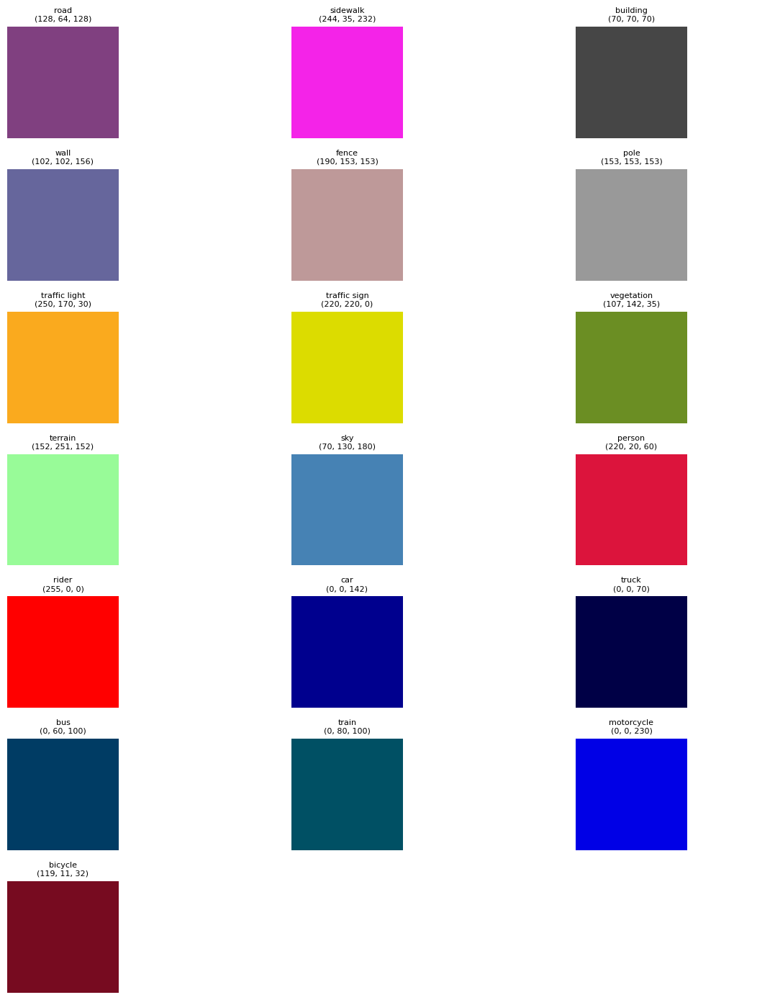

In [14]:
print("Actual Colors:")

# Calculate grid dimensions (3 colors per row)
cols = 3

labels = [label for label in cs_labels.labels if label.trainId != 255 and label.trainId != -1]
rows = (len(labels) + cols - 1) // cols  # Ceiling division

# Create a figure and axes to display the colors in a grid
fig, axes = plt.subplots(rows, cols, figsize=(12, rows * 2))

# Flatten axes array for easier indexing
if rows == 1:
    axes = [axes] if cols == 1 else axes
else:
    axes = axes.flatten()

for i, label in enumerate(labels): 
    color = np.array(label.color) / 255.0  # Normalize RGB values to [0, 1]
    axes[i].imshow([[color]])  # Display the color as a small image
    # Add color name and RGB values to the title
    axes[i].set_title(f"{label.name}\n{label.color}", fontsize=8)
    axes[i].axis('off')  # Hide the axes

# Hide any unused subplots
for i in range(len(labels), len(axes)):
    axes[i].axis('off')

plt.tight_layout()
plt.show()

# DeeplabV3


In [15]:
path_images = "../syn_resized_images"
path_target = "../syn_resized_gt"

image_transform = transforms.Compose([
    transforms.Resize((256, 466)), # We maintain the og aspect ratio
    transforms.ToTensor(),  # Converts PIL Image to Tensor
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]), # Normalize with ImageNet parameters
])

target_transform = transforms.Compose([
    transforms.Resize((256, 466), interpolation=Image.NEAREST), # This interpolation ensure that all pixels have a correct value of their class
    transforms.Lambda(lambda x: torch.from_numpy(np.array(x)).long())
])
syn_dataset = SegmentationDataset(images_dir=path_images, targets_dir=path_target, image_transform=image_transform, target_transform=target_transform)

In [16]:
# Get total dataset size
total_size = len(syn_dataset)
print(f"Total dataset size: {total_size}")

# Calculate split sizes (60% train, 10% val, 30% test)
train_size = int(0.6 * total_size)
val_size = int(0.1 * total_size)
test_size = total_size - train_size - val_size

print(f"Train size: {train_size} ({train_size/total_size*100:.1f}%)")
print(f"Validation size: {val_size} ({val_size/total_size*100:.1f}%)")
print(f"Test size: {test_size} ({test_size/total_size*100:.1f}%)")

# Create random splits
syn_train_dataset, syn_val_dataset, syn_test_dataset = random_split(
    syn_dataset, 
    [train_size, val_size, test_size],
    generator=torch.Generator().manual_seed(SEED)  # For reproducibility
)

# Create DataLoaders
batch_size = 8  


syn_train_dataloader = DataLoader(
    syn_train_dataset,
    batch_size=batch_size,
    shuffle=True,
    #num_workers=2,
    generator=torch.Generator().manual_seed(SEED) 
)


syn_val_dataloader = DataLoader(
    syn_val_dataset,
    batch_size=batch_size,
    shuffle=True,  
    #num_workers=2,
    generator=torch.Generator().manual_seed(SEED)
)

syn_test_dataloader = DataLoader(
    syn_test_dataset,
    batch_size=batch_size,
    shuffle=True,  
    #num_workers=2,
    generator=torch.Generator().manual_seed(SEED)
)

NUM_CLASSES = 19  # Cityscapes
LR = 1e-4


print(f"\nDataLoaders created:")
print(f"Train batches: {len(syn_train_dataloader)}")
print(f"Validation batches: {len(syn_val_dataloader)}")
print(f"Test batches: {len(syn_test_dataloader)}")



Total dataset size: 12500
Train size: 7500 (60.0%)
Validation size: 1250 (10.0%)
Test size: 3750 (30.0%)

DataLoaders created:
Train batches: 938
Validation batches: 157
Test batches: 469


## DeeplabV3 Coco

In [9]:
if DEVICE.type == 'mps': 
    print("mps detected, using no_ssl_verification")
    with no_ssl_verification():
        model = deeplabv3_resnet50(
            weights='COCO_WITH_VOC_LABELS_V1', 
        )
else:
    model = deeplabv3_resnet50(
        weights='COCO_WITH_VOC_LABELS_V1', 
    )

model.classifier[4] = nn.Conv2d(256, NUM_CLASSES, kernel_size=1)
model = model.to(DEVICE)

# Load the best model checkpoint
best_model_path = "models/deeplabv3_resnet50_best_model.pth"
print(f"Loading best model from: {best_model_path}")

checkpoint = torch.load(best_model_path, map_location=DEVICE)
model.load_state_dict(checkpoint['model_state_dict'])

print(f"Best model loaded successfully!")
print(f"Best validation IoU: {checkpoint['val_iou']:.4f}")
print(f"From epoch: {checkpoint['epoch']}")

Loading best model from: models/deeplabv3_resnet50_best_model.pth
Best model loaded successfully!
Best validation IoU: 0.5830
From epoch: 25


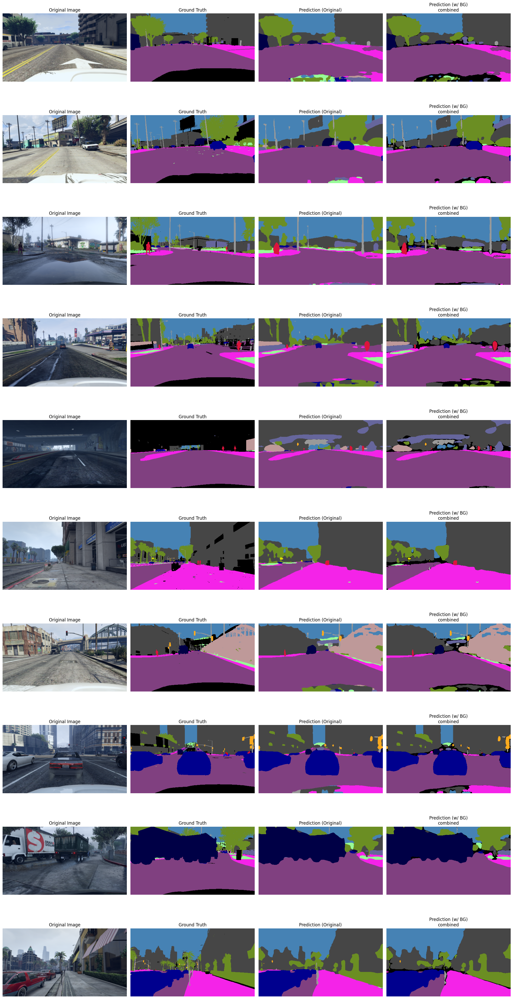


Background Detection Statistics (method: combined):
Sample 0: 8328/119296 pixels (7.0%) classified as background
Sample 1: 3875/119296 pixels (3.2%) classified as background
Sample 2: 4732/119296 pixels (4.0%) classified as background
Sample 3: 7908/119296 pixels (6.6%) classified as background
Sample 4: 5594/119296 pixels (4.7%) classified as background
Sample 5: 2686/119296 pixels (2.3%) classified as background
Sample 6: 6150/119296 pixels (5.2%) classified as background
Sample 7: 3880/119296 pixels (3.3%) classified as background
Sample 8: 1881/119296 pixels (1.6%) classified as background
Sample 9: 3067/119296 pixels (2.6%) classified as background


In [10]:
visualize_segmentation_with_background(model, syn_val_dataloader, num_samples=10, start_idx=0, deterministic=True, 
                                         confidence_threshold=0.5, entropy_threshold=1.0, method='combined')

## DeeplabV3 Imagenet1k

In [11]:
if DEVICE.type == 'mps': 
    print("mps detected, using no_ssl_verification")
    with no_ssl_verification():
        model = deeplabv3_resnet50(
            weights='COCO_WITH_VOC_LABELS_V1', 
            weights_backbone='IMAGENET1K_V1'
        )
else:
    model = deeplabv3_resnet50(
        weights='COCO_WITH_VOC_LABELS_V1', 
        weights_backbone='IMAGENET1K_V1'
    )

model.classifier[4] = nn.Conv2d(256, NUM_CLASSES, kernel_size=1)
model = model.to(DEVICE)

# Load the best model checkpoint
best_model_path = "models/deeplabv3_imagenet1k_best_model.pth"
print(f"Loading best model from: {best_model_path}")

checkpoint = torch.load(best_model_path, map_location=DEVICE)
model.load_state_dict(checkpoint['model_state_dict'])

print(f"Best model loaded successfully!")
print(f"Best validation IoU: {checkpoint['val_iou']:.4f}")
print(f"From epoch: {checkpoint['epoch']}")

Loading best model from: models/deeplabv3_imagenet1k_best_model.pth
Best model loaded successfully!
Best validation IoU: 0.5857
From epoch: 24


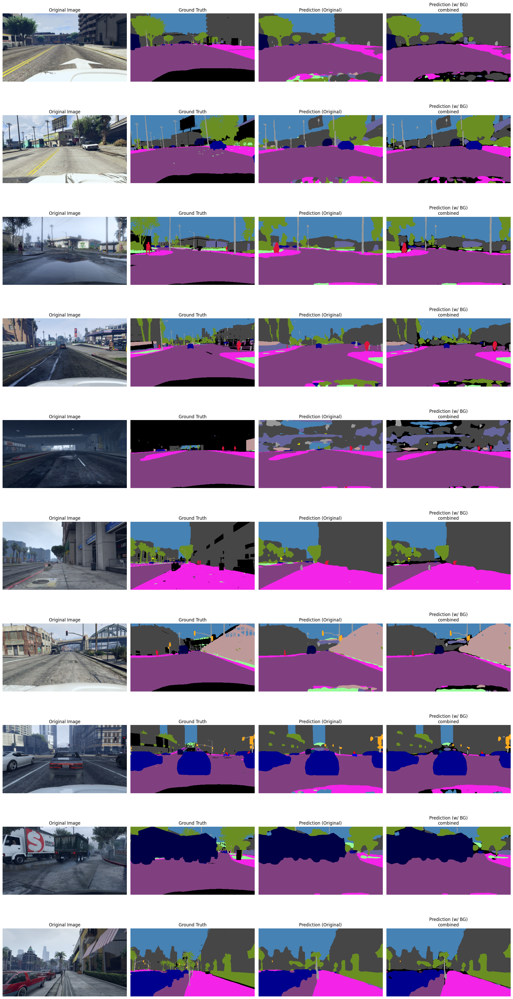


Background Detection Statistics (method: combined):
Sample 0: 8690/119296 pixels (7.3%) classified as background
Sample 1: 6260/119296 pixels (5.2%) classified as background
Sample 2: 3282/119296 pixels (2.8%) classified as background
Sample 3: 7012/119296 pixels (5.9%) classified as background
Sample 4: 13406/119296 pixels (11.2%) classified as background
Sample 5: 2301/119296 pixels (1.9%) classified as background
Sample 6: 5505/119296 pixels (4.6%) classified as background
Sample 7: 3090/119296 pixels (2.6%) classified as background
Sample 8: 1529/119296 pixels (1.3%) classified as background
Sample 9: 2435/119296 pixels (2.0%) classified as background


In [12]:
visualize_segmentation_with_background(model, syn_val_dataloader, num_samples=10, start_idx=0, deterministic=True, 
                                         confidence_threshold=0.5, entropy_threshold=1.0, method='combined')

## DeeplabV3 Imagent1k 480x256

In [18]:
image_transform = transforms.Compose([
    transforms.Resize((256, 480)), 
    transforms.ToTensor(),  # Converts PIL Image to Tensor
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]), # Normalize with ImageNet parameters
])

target_transform = transforms.Compose([
    transforms.Resize((256, 480), interpolation=Image.NEAREST), # This interpolation ensure that all pixels have a correct value of their class
    transforms.Lambda(lambda x: torch.from_numpy(np.array(x)).long())
])
syn_dataset = SegmentationDataset(images_dir=path_images, targets_dir=path_target, image_transform=image_transform, target_transform=target_transform)

# Get total dataset size
total_size = len(syn_dataset)
print(f"Total dataset size: {total_size}")

# Calculate split sizes (60% train, 10% val, 30% test)
train_size = int(0.6 * total_size)
val_size = int(0.1 * total_size)
test_size = total_size - train_size - val_size

print(f"Train size: {train_size} ({train_size/total_size*100:.1f}%)")
print(f"Validation size: {val_size} ({val_size/total_size*100:.1f}%)")
print(f"Test size: {test_size} ({test_size/total_size*100:.1f}%)")

# Create random splits
syn_train_dataset, syn_val_dataset, syn_test_dataset = random_split(
    syn_dataset, 
    [train_size, val_size, test_size],
    generator=torch.Generator().manual_seed(SEED)  # For reproducibility
)

# Create DataLoaders
batch_size = 8  


syn_train_dataloader = DataLoader(
    syn_train_dataset,
    batch_size=batch_size,
    shuffle=True,
    #num_workers=2,
    generator=torch.Generator().manual_seed(SEED) 
)


syn_val_dataloader = DataLoader(
    syn_val_dataset,
    batch_size=batch_size,
    shuffle=True,  
    #num_workers=2,
    generator=torch.Generator().manual_seed(SEED)
)

syn_test_dataloader = DataLoader(
    syn_test_dataset,
    batch_size=batch_size,
    shuffle=True,  
    #num_workers=2,
    generator=torch.Generator().manual_seed(SEED)
)

print(f"\nDataLoaders created:")
print(f"Train batches: {len(syn_train_dataloader)}")
print(f"Validation batches: {len(syn_val_dataloader)}")
print(f"Test batches: {len(syn_test_dataloader)}")

if DEVICE.type == 'mps': 
    print("mps detected, using no_ssl_verification")
    with no_ssl_verification():
        model = deeplabv3_resnet50(
            weights='COCO_WITH_VOC_LABELS_V1', 
            weights_backbone='IMAGENET1K_V1'
        )
else:
    model = deeplabv3_resnet50(
        weights='COCO_WITH_VOC_LABELS_V1', 
        weights_backbone='IMAGENET1K_V1'
    )

model.classifier[4] = nn.Conv2d(256, NUM_CLASSES, kernel_size=1)
model = model.to(DEVICE)

Total dataset size: 12500
Train size: 7500 (60.0%)
Validation size: 1250 (10.0%)
Test size: 3750 (30.0%)

DataLoaders created:
Train batches: 938
Validation batches: 157
Test batches: 469
mps detected, using no_ssl_verification


In [19]:
# Load the best model checkpoint
best_model_path = "../models/deeplabv3_imagenet1k_480x256_best_model.pth"
print(f"Loading best model from: {best_model_path}")

checkpoint = torch.load(best_model_path, map_location=DEVICE)
model.load_state_dict(checkpoint['model_state_dict'])

print(f"Best model loaded successfully!")
print(f"Best validation IoU: {checkpoint['val_iou']:.4f}")
print(f"From epoch: {checkpoint['epoch']}")

Loading best model from: ../models/deeplabv3_imagenet1k_480x256_best_model.pth
Best model loaded successfully!
Best validation IoU: 0.5857
From epoch: 25


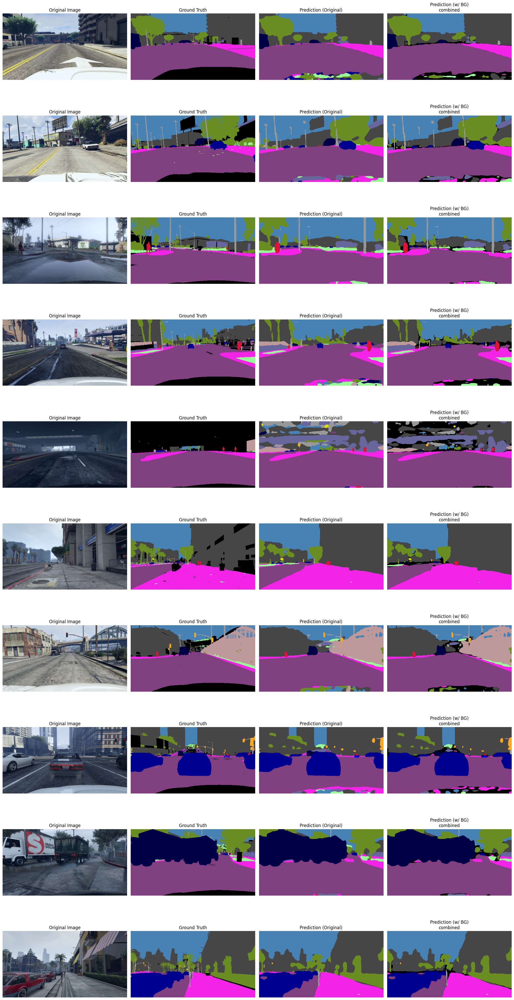


Background Detection Statistics (method: combined):
Sample 0: 9274/122880 pixels (7.5%) classified as background
Sample 1: 5317/122880 pixels (4.3%) classified as background
Sample 2: 3110/122880 pixels (2.5%) classified as background
Sample 3: 8818/122880 pixels (7.2%) classified as background
Sample 4: 18820/122880 pixels (15.3%) classified as background
Sample 5: 2413/122880 pixels (2.0%) classified as background
Sample 6: 6577/122880 pixels (5.4%) classified as background
Sample 7: 6317/122880 pixels (5.1%) classified as background
Sample 8: 2358/122880 pixels (1.9%) classified as background
Sample 9: 2577/122880 pixels (2.1%) classified as background


In [15]:
visualize_segmentation_with_background(model, syn_val_dataloader, num_samples=10, start_idx=0, deterministic=True, 
                                         confidence_threshold=0.5, entropy_threshold=1.0, method='combined')

# Unet

## Unet Imagenet1k

In [21]:
path_images = "../syn_resized_images"
path_target = "../syn_resized_gt"

image_transform = transforms.Compose([
    transforms.Resize((256, 466)), # We maintain the og aspect ratio
    transforms.ToTensor(),  # Converts PIL Image to Tensor
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]), # Normalize with ImageNet parameters
])

target_transform = transforms.Compose([
    transforms.Resize((256, 466), interpolation=Image.NEAREST), # This interpolation ensure that all pixels have a correct value of their class
    transforms.Lambda(lambda x: torch.from_numpy(np.array(x)).long())
])
syn_dataset = SegmentationDataset(images_dir=path_images, targets_dir=path_target, image_transform=image_transform, target_transform=target_transform)

# Get total dataset size
total_size = len(syn_dataset)
print(f"Total dataset size: {total_size}")

# Calculate split sizes (60% train, 10% val, 30% test)
train_size = int(0.6 * total_size)
val_size = int(0.1 * total_size)
test_size = total_size - train_size - val_size

print(f"Train size: {train_size} ({train_size/total_size*100:.1f}%)")
print(f"Validation size: {val_size} ({val_size/total_size*100:.1f}%)")
print(f"Test size: {test_size} ({test_size/total_size*100:.1f}%)")

# Create random splits
syn_train_dataset, syn_val_dataset, syn_test_dataset = random_split(
    syn_dataset, 
    [train_size, val_size, test_size],
    generator=torch.Generator().manual_seed(SEED)  # For reproducibility
)

# Create DataLoaders
batch_size = 8  


syn_train_dataloader = DataLoader(
    syn_train_dataset,
    batch_size=batch_size,
    shuffle=True,
    #num_workers=2,
    generator=torch.Generator().manual_seed(SEED) 
)


syn_val_dataloader = DataLoader(
    syn_val_dataset,
    batch_size=batch_size,
    shuffle=True,  
    #num_workers=2,
    generator=torch.Generator().manual_seed(SEED)
)

syn_test_dataloader = DataLoader(
    syn_test_dataset,
    batch_size=batch_size,
    shuffle=True,  
    #num_workers=2,
    generator=torch.Generator().manual_seed(SEED)
)

print(f"\nDataLoaders created:")
print(f"Train batches: {len(syn_train_dataloader)}")
print(f"Validation batches: {len(syn_val_dataloader)}")
print(f"Test batches: {len(syn_test_dataloader)}")

Total dataset size: 12500
Train size: 7500 (60.0%)
Validation size: 1250 (10.0%)
Test size: 3750 (30.0%)

DataLoaders created:
Train batches: 938
Validation batches: 157
Test batches: 469


In [17]:
class PaddedUnet(nn.Module):
    def __init__(self, backbone='resnet50', pretrained=True, in_channels=3, num_classes=19):
        super(PaddedUnet, self).__init__()
        # Initialize the original UNet model
        self.unet = Unet(
            backbone=backbone,
            pretrained=pretrained,
            in_channels=in_channels,
            num_classes=num_classes,
        )
        
    def forward(self, x):
        # Save original dimensions for reference
        orig_dim = x.shape[2:]
        
        # Encoder gives us a list of embeddings, one for each level
        embeddings = self.unet.encoder(x)
        embeddings.reverse()  # Reverse order to mach decoding 
        
        # Manual decoding with padding fixes
        x = embeddings[0]
        
        for i, block in enumerate(self.unet.decoder.blocks):
            # Get skip connection if available
            skip = embeddings[i+1] if i+1 < len(embeddings) else None
            
            # Handle upscaling if needed
            if block.scale_factor > 1:
                x = F.interpolate(x, scale_factor=block.scale_factor, mode='nearest')
            
            # Apply padding to match dimensions instead of resizing
            # Needed since input shape is not divisible by 32
            if skip is not None:
                # Check if shapes need adjustment
                if x.shape[2:] != skip.shape[2:]:
                    # Calculate padding needed
                    h_diff = x.shape[2] - skip.shape[2]
                    w_diff = x.shape[3] - skip.shape[3]
                    
                    # Apply padding to match dimensions
                    if h_diff > 0 or w_diff > 0:
                        # Calculate padding values
                        print(f"Padding skip connection from {skip.shape[2:]} to {x.shape[2:]}")
                        pad_h = (h_diff // 2, h_diff - h_diff // 2)
                        pad_w = (w_diff // 2, w_diff - w_diff // 2)
                        skip = F.pad(skip, [pad_w[0], pad_w[1], pad_h[0], pad_h[1]])
                    elif h_diff < 0 or w_diff < 0:
                        # Need to pad the x tensor instead
                        print("padding tensor")
                        h_diff = -h_diff
                        w_diff = -w_diff
                        pad_h = (h_diff // 2, h_diff - h_diff // 2)
                        pad_w = (w_diff // 2, w_diff - w_diff // 2)
                        x = F.pad(x, [pad_w[0], pad_w[1], pad_h[0], pad_h[1]])
                
                # Concatenate skip connection with current features
                x = torch.cat([x, skip], dim=1)
                
            # Apply convolutions
            x = block.conv1(x)
            x = block.conv2(x)
        
        # Apply final convolution
        x = self.unet.decoder.final_conv(x)
        
        # Ensure output matches input dimensions if needed
        if x.shape[2:] != orig_dim:
            x = F.interpolate(x, size=orig_dim, mode='bilinear', align_corners=False)
        
        return {'out': x}

if DEVICE.type == 'mps':
    print("mps detected, using no_ssl_verification")
    with no_ssl_verification():
        model = PaddedUnet(
            backbone='resnet50',
            pretrained=True,
            in_channels=3,
            num_classes=NUM_CLASSES,
        )
else:
    model = PaddedUnet(
        backbone='resnet50',
        pretrained=True,
        in_channels=3,
        num_classes=NUM_CLASSES,
    )

model = model.to(DEVICE)

# Load the best model checkpoint
best_model_path = "models/unet_imagenet1k_best_model.pth"
print(f"Loading best model from: {best_model_path}")

checkpoint = torch.load(best_model_path, map_location=DEVICE)
model.load_state_dict(checkpoint['model_state_dict'])

print(f"Best model loaded successfully!")
print(f"Best validation IoU: {checkpoint['val_iou']:.4f}")
print(f"From epoch: {checkpoint['epoch']}")

Loading best model from: models/unet_imagenet1k_best_model.pth
Best model loaded successfully!
Best validation IoU: 0.5690
From epoch: 25


Padding skip connection from torch.Size([32, 59]) to torch.Size([32, 60])
Padding skip connection from torch.Size([64, 117]) to torch.Size([64, 120])
Padding skip connection from torch.Size([128, 233]) to torch.Size([128, 240])


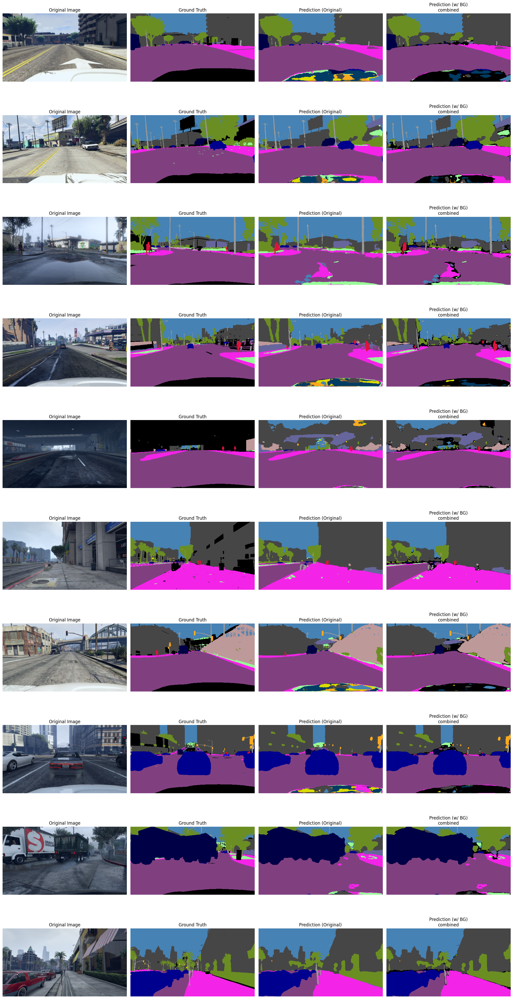


Background Detection Statistics (method: combined):
Sample 0: 11504/119296 pixels (9.6%) classified as background
Sample 1: 9085/119296 pixels (7.6%) classified as background
Sample 2: 4061/119296 pixels (3.4%) classified as background
Sample 3: 10926/119296 pixels (9.2%) classified as background
Sample 4: 6855/119296 pixels (5.7%) classified as background
Sample 5: 2150/119296 pixels (1.8%) classified as background
Sample 6: 9881/119296 pixels (8.3%) classified as background
Sample 7: 9286/119296 pixels (7.8%) classified as background
Sample 8: 2821/119296 pixels (2.4%) classified as background
Sample 9: 1915/119296 pixels (1.6%) classified as background


In [18]:
visualize_segmentation_with_background(model, syn_val_dataloader, num_samples=10, start_idx=0, deterministic=True, 
                                         confidence_threshold=0.5, entropy_threshold=1.0, method='combined')

## Unet Imagenet1k 480x256

In [22]:
image_transform = transforms.Compose([
    transforms.Resize((256, 480)), # We augment from 466x256 to 480x256 in order to avoid the padding artifacts
    transforms.ToTensor(),  # Converts PIL Image to Tensor
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]), # Normalize with ImageNet parameters
])

target_transform = transforms.Compose([
    transforms.Resize((256, 480), interpolation=Image.NEAREST), # This interpolation ensure that all pixels have a correct value of their class
    transforms.Lambda(lambda x: torch.from_numpy(np.array(x)).long())
])
syn_dataset = SegmentationDataset(images_dir=path_images, targets_dir=path_target, image_transform=image_transform, target_transform=target_transform)

# Get total dataset size
total_size = len(syn_dataset)
print(f"Total dataset size: {total_size}")

# Calculate split sizes (60% train, 10% val, 30% test)
train_size = int(0.6 * total_size)
val_size = int(0.1 * total_size)
test_size = total_size - train_size - val_size

print(f"Train size: {train_size} ({train_size/total_size*100:.1f}%)")
print(f"Validation size: {val_size} ({val_size/total_size*100:.1f}%)")
print(f"Test size: {test_size} ({test_size/total_size*100:.1f}%)")

# Create random splits
syn_train_dataset, syn_val_dataset, syn_test_dataset = random_split(
    syn_dataset, 
    [train_size, val_size, test_size],
    generator=torch.Generator().manual_seed(SEED)  # For reproducibility
)

# Create DataLoaders
batch_size = 8  


syn_train_dataloader = DataLoader(
    syn_train_dataset,
    batch_size=batch_size,
    shuffle=True,
    #num_workers=2,
    generator=torch.Generator().manual_seed(SEED) 
)


syn_val_dataloader = DataLoader(
    syn_val_dataset,
    batch_size=batch_size,
    shuffle=True,  
    #num_workers=2,
    generator=torch.Generator().manual_seed(SEED)
)

syn_test_dataloader = DataLoader(
    syn_test_dataset,
    batch_size=batch_size,
    shuffle=True,  
    #num_workers=2,
    generator=torch.Generator().manual_seed(SEED)
)

print(f"\nDataLoaders created:")
print(f"Train batches: {len(syn_train_dataloader)}")
print(f"Validation batches: {len(syn_val_dataloader)}")
print(f"Test batches: {len(syn_test_dataloader)}")

Total dataset size: 12500
Train size: 7500 (60.0%)
Validation size: 1250 (10.0%)
Test size: 3750 (30.0%)

DataLoaders created:
Train batches: 938
Validation batches: 157
Test batches: 469


In [23]:
if DEVICE.type == 'mps':
    print("mps detected, using no_ssl_verification")
    with no_ssl_verification():
        model = Unet(
            backbone='resnet50',
            pretrained=True,
            in_channels=3,
            num_classes=NUM_CLASSES,
        )
else:
    model = Unet(
        backbone='resnet50',
        pretrained=True,
        in_channels=3,
        num_classes=NUM_CLASSES,
    )

model = model.to(DEVICE)

# Load the best model checkpoint
best_model_path = "../models/unet_imagenet1k_480x256_best_model.pth"
print(f"Loading best model from: {best_model_path}")

checkpoint = torch.load(best_model_path, map_location=DEVICE)
model.load_state_dict(checkpoint['model_state_dict'])

print(f"Best model loaded successfully!")
print(f"Best validation IoU: {checkpoint['val_iou']:.4f}")
print(f"From epoch: {checkpoint['epoch']}")

mps detected, using no_ssl_verification
Loading best model from: ../models/unet_imagenet1k_480x256_best_model.pth
Best model loaded successfully!
Best validation IoU: 0.5983
From epoch: 24


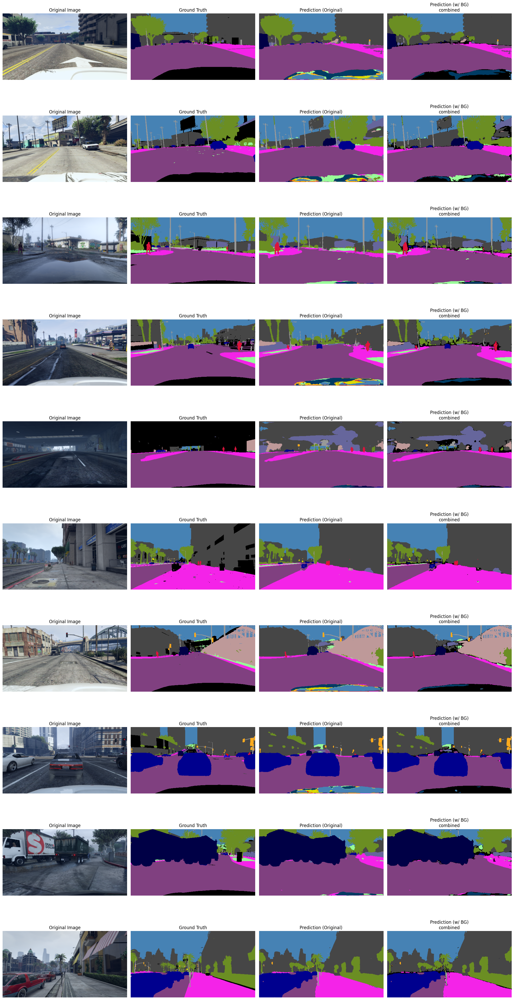


Background Detection Statistics (method: combined):
Sample 0: 10753/122880 pixels (8.8%) classified as background
Sample 1: 9270/122880 pixels (7.5%) classified as background
Sample 2: 3576/122880 pixels (2.9%) classified as background
Sample 3: 9918/122880 pixels (8.1%) classified as background
Sample 4: 5815/122880 pixels (4.7%) classified as background
Sample 5: 1758/122880 pixels (1.4%) classified as background
Sample 6: 10128/122880 pixels (8.2%) classified as background
Sample 7: 10306/122880 pixels (8.4%) classified as background
Sample 8: 2778/122880 pixels (2.3%) classified as background
Sample 9: 1769/122880 pixels (1.4%) classified as background


In [21]:
visualize_segmentation_with_background(model, syn_val_dataloader, num_samples=10, start_idx=0, deterministic=True, 
                                         confidence_threshold=0.5, entropy_threshold=1.0, method='combined')

# Confrontation DeeplabV3 - Unet 480x250

In [24]:
def visualize_model_comparison(model_a, model_b, dataloader, model_a_name="Model A", model_b_name="Model B",
                             num_samples=4, start_idx=0, deterministic=False, 
                             confidence_threshold=0.5, entropy_threshold=1.0, method='combined'):
    """
    Visualize and compare segmentation results between two models with background detection
    
    Args:
        model_a: First model to evaluate
        model_b: Second model to evaluate
        dataloader: DataLoader containing images and targets
        model_a_name: Name for the first model (for titles)
        model_b_name: Name for the second model (for titles)
        num_samples: Number of samples to visualize
        start_idx: Starting index for deterministic sampling
        deterministic: If True, select images deterministically by index
        confidence_threshold: Minimum confidence for non-background classification
        entropy_threshold: Maximum entropy for non-background classification
        method: Background detection method ('entropy', 'confidence', 'combined')
    """
    model_a.eval()
    model_b.eval()
    
    # Get images for visualization (using your existing logic)
    if deterministic:
        dataset = dataloader.dataset
        
        if hasattr(dataset, 'dataset') and hasattr(dataset, 'indices'):
            orig_dataset = dataset.dataset
            indices = dataset.indices
            selected_indices = indices[start_idx:start_idx + num_samples]
            
            images = []
            targets = []
            for idx in selected_indices:
                img, tgt = orig_dataset[idx]
                images.append(img.unsqueeze(0))
                targets.append(tgt.unsqueeze(0))
            
            images = torch.cat(images, dim=0)
            targets = torch.cat(targets, dim=0)
        else:
            images = []
            targets = []
            for i in range(start_idx, min(start_idx + num_samples, len(dataset))):
                img, tgt = dataset[i]
                images.append(img.unsqueeze(0))
                targets.append(tgt.unsqueeze(0))
            
            images = torch.cat(images, dim=0)
            targets = torch.cat(targets, dim=0)
    else:
        images, targets = next(iter(dataloader))
        images = images[:num_samples]
        targets = targets[:num_samples]
    
    images = images[:num_samples].to(DEVICE)
    targets = targets[:num_samples].to(DEVICE)
    
    # Process both models
    with torch.no_grad():
        # Model A predictions
        outputs_a = model_a(images)
        if isinstance(outputs_a, dict) and 'out' in outputs_a:
            outputs_a = outputs_a['out']
        
        probabilities_a = F.softmax(outputs_a, dim=1)
        max_probs_a, predictions_a = torch.max(probabilities_a, dim=1)
        entropy_a = -torch.sum(probabilities_a * torch.log(probabilities_a + 1e-8), dim=1)
        
        # Model B predictions
        outputs_b = model_b(images)
        if isinstance(outputs_b, dict) and 'out' in outputs_b:
            outputs_b = outputs_b['out']
        
        probabilities_b = F.softmax(outputs_b, dim=1)
        max_probs_b, predictions_b = torch.max(probabilities_b, dim=1)
        entropy_b = -torch.sum(probabilities_b * torch.log(probabilities_b + 1e-8), dim=1)
        
        # Apply background detection for both models
        def get_background_mask(max_probs, entropy, method):
            if method == 'confidence':
                return max_probs < confidence_threshold
            elif method == 'entropy':
                return entropy > entropy_threshold
            elif method == 'combined':
                return (max_probs < confidence_threshold) | (entropy > entropy_threshold)
            else:
                return torch.zeros_like(max_probs, dtype=torch.bool)
        
        background_mask_a = get_background_mask(max_probs_a, entropy_a, method)
        background_mask_b = get_background_mask(max_probs_b, entropy_b, method)
        
        # Create predictions with background
        predictions_with_bg_a = predictions_a.clone()
        predictions_with_bg_a[background_mask_a] = 255
        
        predictions_with_bg_b = predictions_b.clone()
        predictions_with_bg_b[background_mask_b] = 255
    
    # Move to CPU for visualization
    images = images.cpu()
    targets = targets.cpu()
    predictions_a = predictions_a.cpu()
    predictions_b = predictions_b.cpu()
    predictions_with_bg_a = predictions_with_bg_a.cpu()
    predictions_with_bg_b = predictions_with_bg_b.cpu()
    max_probs_a = max_probs_a.cpu()
    max_probs_b = max_probs_b.cpu()
    entropy_a = entropy_a.cpu()
    entropy_b = entropy_b.cpu()
    
    def apply_color_map_with_background(seg_map):
        """Apply color mapping to segmentation map with black background"""
        colored_map = np.zeros((seg_map.shape[0], seg_map.shape[1], 3), dtype=np.uint8)
        
        # Get valid labels (excluding ignore classes)
        valid_labels = [label for label in cs_labels.labels if label.trainId != 255 and label.trainId != -1]
        
        for label in valid_labels:
            mask = seg_map == label.trainId
            colored_map[mask] = label.color
        
        # Background pixels remain black (0, 0, 0)
        return colored_map
    
    # Plot results with 6 columns: OG - GT - Pred A - Pred B - Pred A w/BG - Pred B w/BG
    fig, axes = plt.subplots(num_samples, 6, figsize=(30, num_samples * 4))
    if num_samples == 1:
        axes = axes.reshape(1, -1)
    
    for i in range(min(num_samples, len(images))):
        # Original image
        img = images[i].permute(1, 2, 0).numpy()
        img = (img - img.min()) / (img.max() - img.min())
        axes[i, 0].imshow(img)
        axes[i, 0].set_title('Original Image')
        axes[i, 0].axis('off')
        
        # Ground truth
        gt_colored = apply_color_map_with_background(targets[i].numpy())
        axes[i, 1].imshow(gt_colored)
        axes[i, 1].set_title('Ground Truth')
        axes[i, 1].axis('off')
        
        # Model A prediction
        pred_a_colored = apply_color_map_with_background(predictions_a[i].numpy())
        axes[i, 2].imshow(pred_a_colored)
        axes[i, 2].set_title(f'{model_a_name}\nPrediction')
        axes[i, 2].axis('off')
        
        # Model B prediction
        pred_b_colored = apply_color_map_with_background(predictions_b[i].numpy())
        axes[i, 3].imshow(pred_b_colored)
        axes[i, 3].set_title(f'{model_b_name}\nPrediction')
        axes[i, 3].axis('off')
        
        # Model A prediction with background
        pred_a_bg_colored = apply_color_map_with_background(predictions_with_bg_a[i].numpy())
        axes[i, 4].imshow(pred_a_bg_colored)
        axes[i, 4].set_title(f'{model_a_name}\nw/ BG ({method})')
        axes[i, 4].axis('off')
        
        # Model B prediction with background
        pred_b_bg_colored = apply_color_map_with_background(predictions_with_bg_b[i].numpy())
        axes[i, 5].imshow(pred_b_bg_colored)
        axes[i, 5].set_title(f'{model_b_name}\nw/ BG ({method})')
        axes[i, 5].axis('off')
    
    plt.tight_layout()
    plt.show()

In [25]:
if DEVICE.type == 'mps': 
    print("mps detected, using no_ssl_verification")
    with no_ssl_verification():
        model_deeplab = deeplabv3_resnet50(
            weights='COCO_WITH_VOC_LABELS_V1', 
            weights_backbone='IMAGENET1K_V1'
        )
else:
    model_deeplab = deeplabv3_resnet50(
        weights='COCO_WITH_VOC_LABELS_V1', 
        weights_backbone='IMAGENET1K_V1'
    )

model_deeplab.classifier[4] = nn.Conv2d(256, NUM_CLASSES, kernel_size=1)
model_deeplab = model_deeplab.to(DEVICE)

best_model_path = "../models/deeplabv3_imagenet1k_480x256_best_model.pth"
#best_model_path = "models/deeplabv3_imagenet1k_best_model.pth"
print(f"Loading best model from: {best_model_path}")
checkpoint = torch.load(best_model_path, map_location=DEVICE)
model_deeplab.load_state_dict(checkpoint['model_state_dict'])
print(f"Best model loaded successfully!")
print(f"Best validation IoU: {checkpoint['val_iou']:.4f}")
print(f"From epoch: {checkpoint['epoch']}")

print("--"*20)

if DEVICE.type == 'mps':
    print("mps detected, using no_ssl_verification")
    with no_ssl_verification():
        model_unet = Unet(
            backbone='resnet50',
            pretrained=True,
            in_channels=3,
            num_classes=NUM_CLASSES,
        )
else:
    model_unet = Unet(
        backbone='resnet50',
        pretrained=True,
        in_channels=3,
        num_classes=NUM_CLASSES,
    )

model_unet = model_unet.to(DEVICE)

# Load the best model checkpoint
best_model_path = "../models/unet_imagenet1k_480x256_best_model.pth"
print(f"Loading best model from: {best_model_path}")

checkpoint = torch.load(best_model_path, map_location=DEVICE)
model_unet.load_state_dict(checkpoint['model_state_dict'])

print(f"Best model loaded successfully!")
print(f"Best validation IoU: {checkpoint['val_iou']:.4f}")
print(f"From epoch: {checkpoint['epoch']}")

mps detected, using no_ssl_verification
Loading best model from: ../models/deeplabv3_imagenet1k_480x256_best_model.pth
Best model loaded successfully!
Best validation IoU: 0.5857
From epoch: 25
----------------------------------------
mps detected, using no_ssl_verification
Loading best model from: ../models/unet_imagenet1k_480x256_best_model.pth
Best model loaded successfully!
Best validation IoU: 0.5983
From epoch: 24


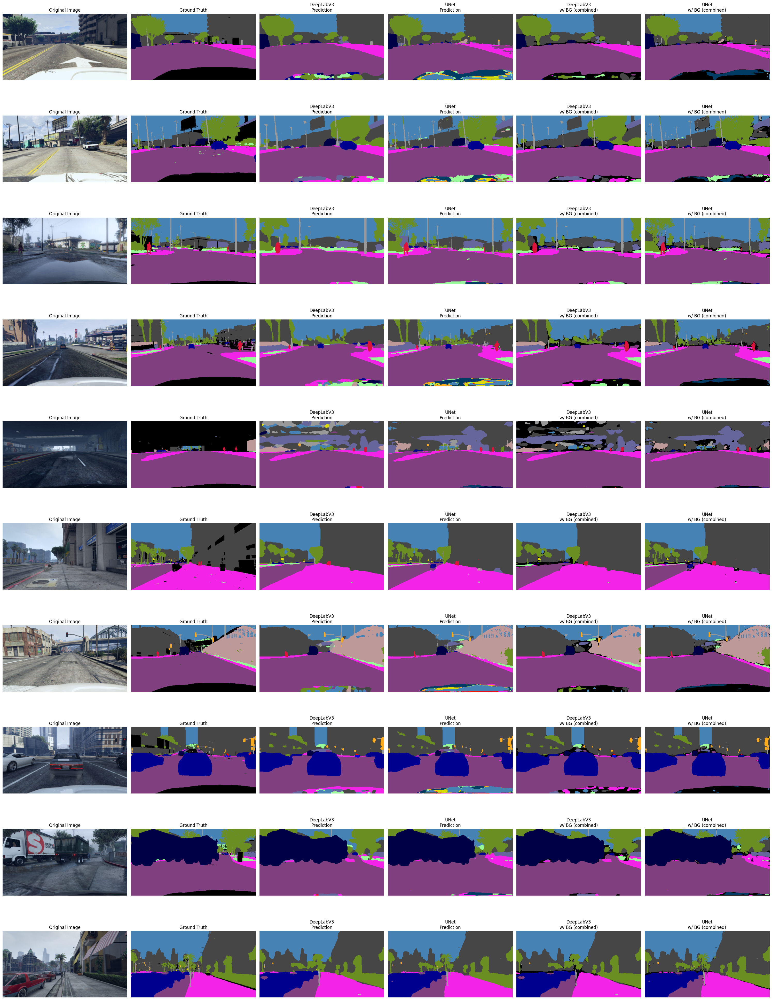

In [27]:
visualize_model_comparison(model_deeplab, model_unet, syn_val_dataloader,
                          model_a_name="DeepLabV3", model_b_name="UNet",
                          num_samples=10, start_idx=0, deterministic=True,
                          confidence_threshold=0.5, entropy_threshold=1.0, method='combined')

## TEST

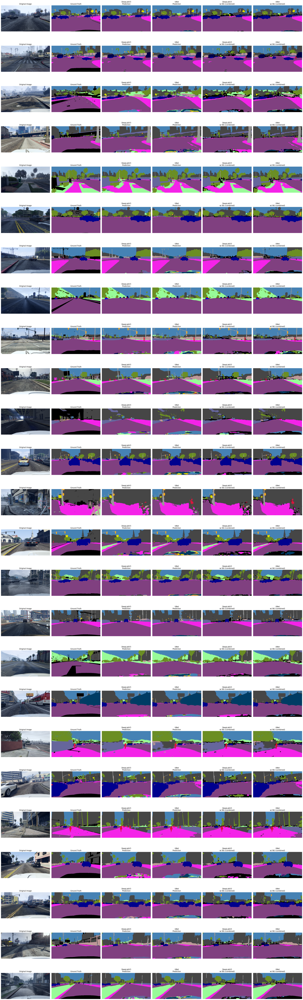

In [28]:
visualize_model_comparison(model_deeplab, model_unet, syn_test_dataloader,
                          model_a_name="DeepLabV3", model_b_name="UNet",
                          num_samples=25, start_idx=0, deterministic=True,
                          confidence_threshold=0.5, entropy_threshold=1.0, method='combined')